In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os
from sklearn.metrics import confusion_matrix
import seaborn as sns

* Таблица с дистанциями между исходным и уменьшенным изображениями для каждой персоны в наборе данных
* Графики с ломанными линиями, показывающие зависимость метрики сходства от разрешения входного изображения
* Графики рассеяния значений метрик сходства между исходных изображением и его уменьшенными версиями

In [2]:
input_folder = '/tf/data/miem_face_recognition/experiment_2'

In [2]:
model_names = [
    "VGG-Face",
    "Facenet",
    "Facenet512",
    "OpenFace",
    "DeepFace",
    "DeepID",
    "ArcFace",
    "SFace"
]

resolutions = [1024, 768, 512, 256, 224, 128, 112, 96, 64, 32]

thresholds = {
     "VGG-Face": 1.17,
    "Facenet": 0.8,
    "Facenet512": 1.04,
    "OpenFace": 0.55,
    "DeepFace": 0.64,
    "DeepID": 0.17,
    "ArcFace": 1.13,
    "SFace": 1.055,
}

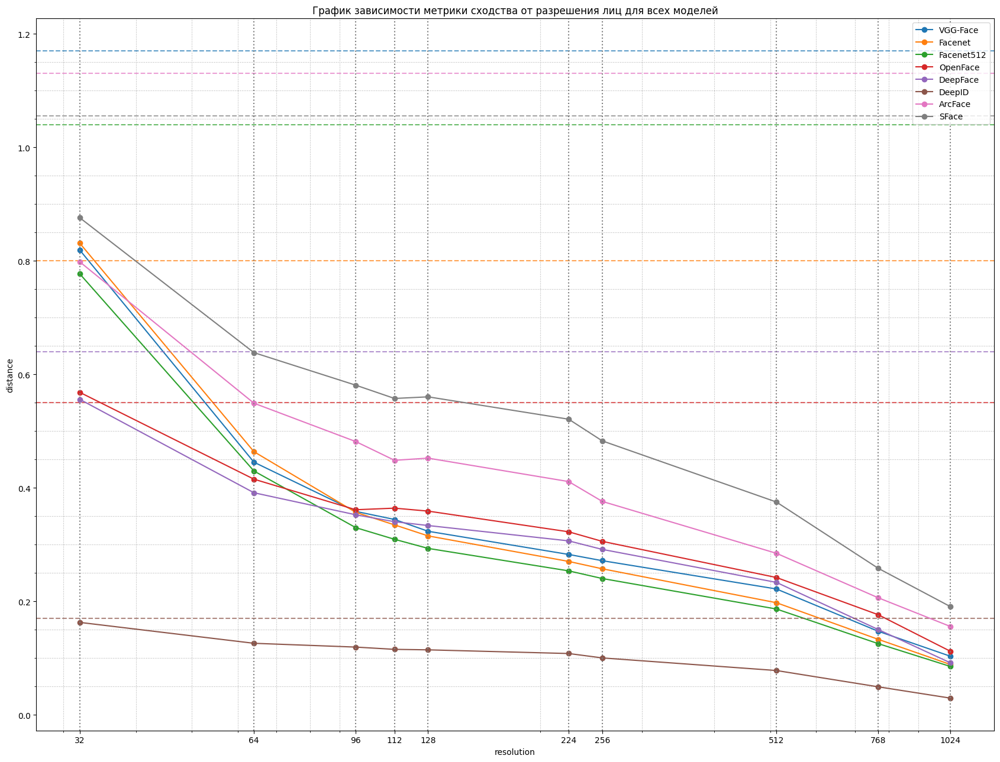

In [6]:
plt.figure(figsize=(17, 13))

avg_distances_dict = {}

for model in model_names:
    all_distances_for_resolutions = []

    for file_name in os.listdir(input_folder):
        if file_name.endswith(".csv") and model in file_name:
            file_path = os.path.join(input_folder, file_name)

            df = pd.read_csv(file_path)

            distances_for_resolutions = [df.loc[:, f'{resolution}_distance'].mean() for resolution in resolutions]
            all_distances_for_resolutions.append(distances_for_resolutions)

    if all_distances_for_resolutions:
          avg_distances = pd.DataFrame(all_distances_for_resolutions).mean().tolist()
          avg_distances_dict[model] = avg_distances
          plt.plot(resolutions, avg_distances, marker='o', label=f'{model}')

          threshold = thresholds.get(model, None)
          if threshold is not None:
            # https://stackoverflow.com/questions/36699155/how-to-get-color-of-most-recent-plotted-line-in-pythons-plt
            threshold_color = plt.gca().lines[-1].get_color()
            plt.axhline(y=threshold, linestyle='--', color=threshold_color, alpha=0.7)

for resolution in resolutions:
    plt.axvline(x=resolution, linestyle=':', color='gray')

plt.xscale('log')
plt.minorticks_on()
plt.grid(which='minor', linestyle=':')
plt.title('График зависимости метрики сходства от разрешения лиц для всех моделей')
plt.xlabel('resolution')
plt.ylabel('distance')
plt.xticks(resolutions, resolutions)
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

In [7]:
deviations = {}

for model, distances in avg_distances_dict.items():
  threshold = thresholds.get(model, None)
  if threshold is not None:
    deviations[model] = [(threshold - distance) for distance in distances]

normalized_deviations = {}

for model, deviations in deviations.items():
    min_deviation = min(deviations)
    max_deviation = max(deviations)
    normalized_deviations[model] = [(dev - min_deviation) / (max_deviation - min_deviation) for dev in deviations]

print(normalized_deviations)

{'VGG-Face': [1.0, 0.9384303026469035, 0.834247594611609, 0.7646287461848571, 0.7492624140575239, 0.6922137315206212, 0.6631503260725314, 0.6433203088470494, 0.5221374615902044, 0.0], 'Facenet': [1.0, 0.940234717545757, 0.8532448529669403, 0.772724551291002, 0.7552497305014406, 0.6946586518054111, 0.6685209858756122, 0.6387840527213293, 0.49475308985784133, 0.0], 'Facenet512': [1.0, 0.9417910108631156, 0.8535227300097515, 0.7758676383624582, 0.756403720533828, 0.6991486670884958, 0.676018197257424, 0.6463728784900742, 0.5019997995654125, 0.0], 'OpenFace': [1.0, 0.8586709539232371, 0.7148694313806805, 0.5753261472614998, 0.5384214000365637, 0.458524248482096, 0.4471129273081906, 0.45323173995130606, 0.33525885088803353, 0.0], 'DeepFace': [1.0, 0.8735579384557749, 0.6945234518906546, 0.5693886588262331, 0.5370323404135305, 0.4787981074630401, 0.46430179346745115, 0.4380502048697356, 0.35441588022605275, 0.0], 'DeepID': [1.0, 0.850663560860514, 0.6352831504658706, 0.4688982674833982, 0.41

In [8]:
mean_deviations = {model: sum(deviations) / len(deviations) for model, deviations in normalized_deviations.items()}

for model, mean_deviation in mean_deviations.items():
    print(f"{model}: {mean_deviation}")

VGG-Face: 0.68073908855313
Facenet: 0.6818170632565334
Facenet512: 0.685112464217056
OpenFace: 0.5381415699231608
DeepFace: 0.5410068375612472
DeepID: 0.4685627178370475
ArcFace: 0.5942465925792726
SFace: 0.5425940354454971


In [9]:
mean_deviations_sorted = dict(sorted(mean_deviations.items(), key=lambda x:x[1]))
print(mean_deviations_sorted)

{'DeepID': 0.4685627178370475, 'OpenFace': 0.5381415699231608, 'DeepFace': 0.5410068375612472, 'SFace': 0.5425940354454971, 'ArcFace': 0.5942465925792726, 'VGG-Face': 0.68073908855313, 'Facenet': 0.6818170632565334, 'Facenet512': 0.685112464217056}


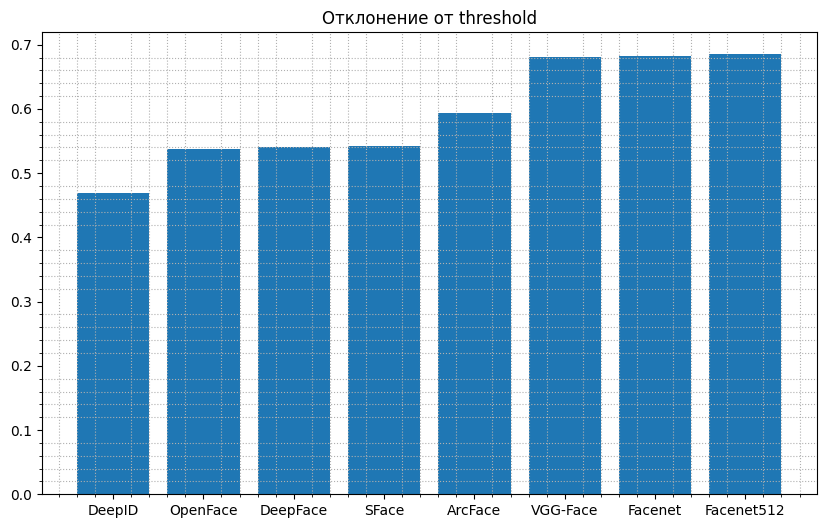

In [11]:
models = list(mean_deviations_sorted.keys())
result = list(mean_deviations_sorted.values())

plt.figure(figsize=(10, 6))
plt.minorticks_on()
plt.grid(which='minor', linestyle=':')
plt.bar(models, result)
plt.title('Отклонение от threshold');

In [3]:
input_folder = '/tf/data/miem_face_recognition/experiment_2/results_FR_0803' 

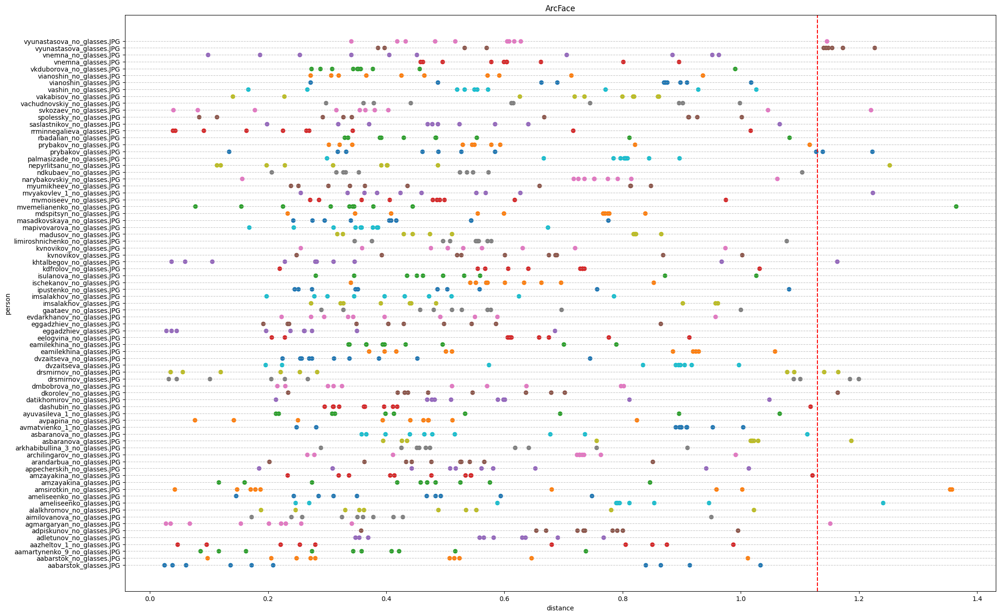

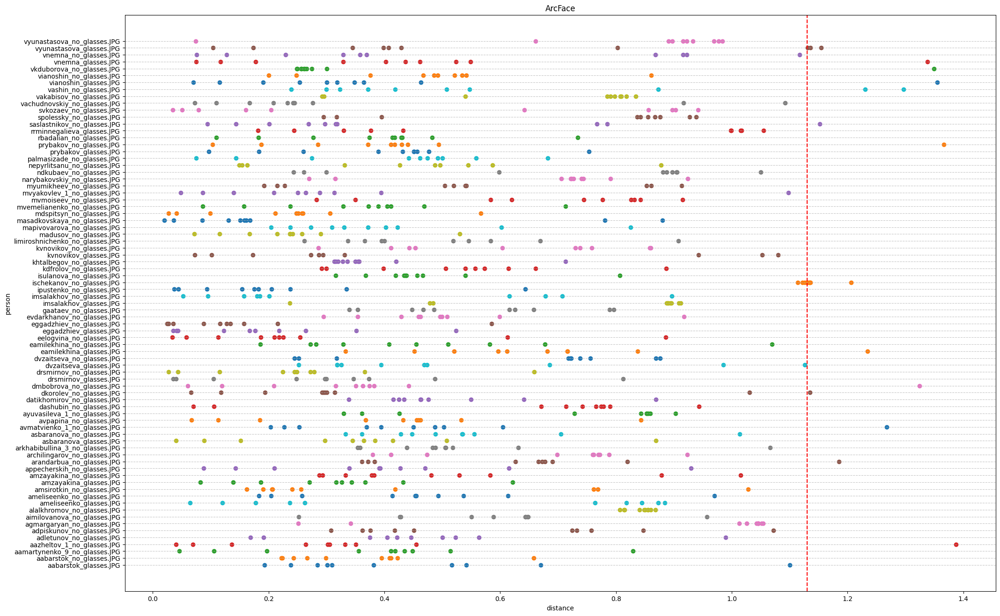

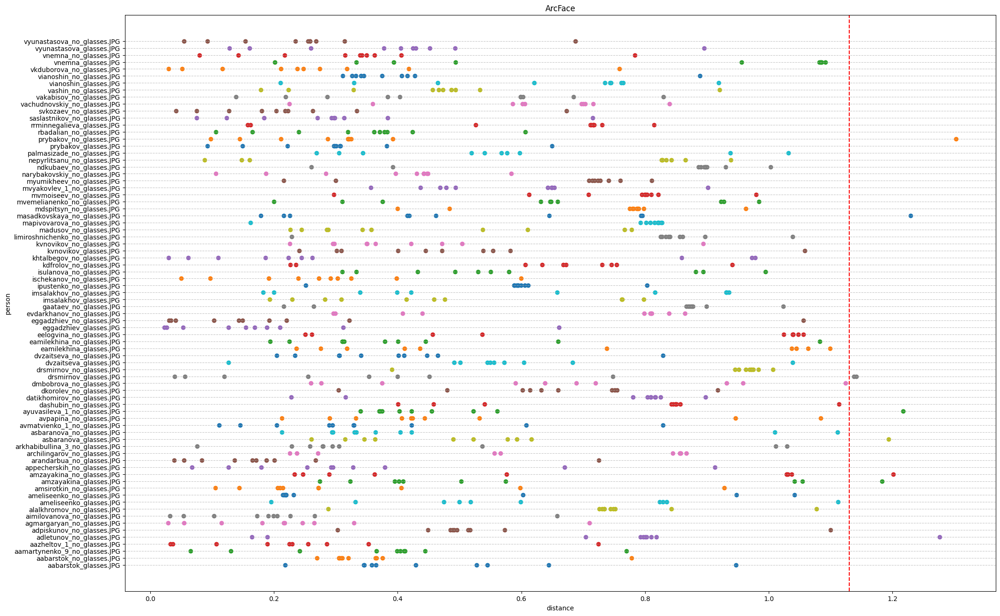

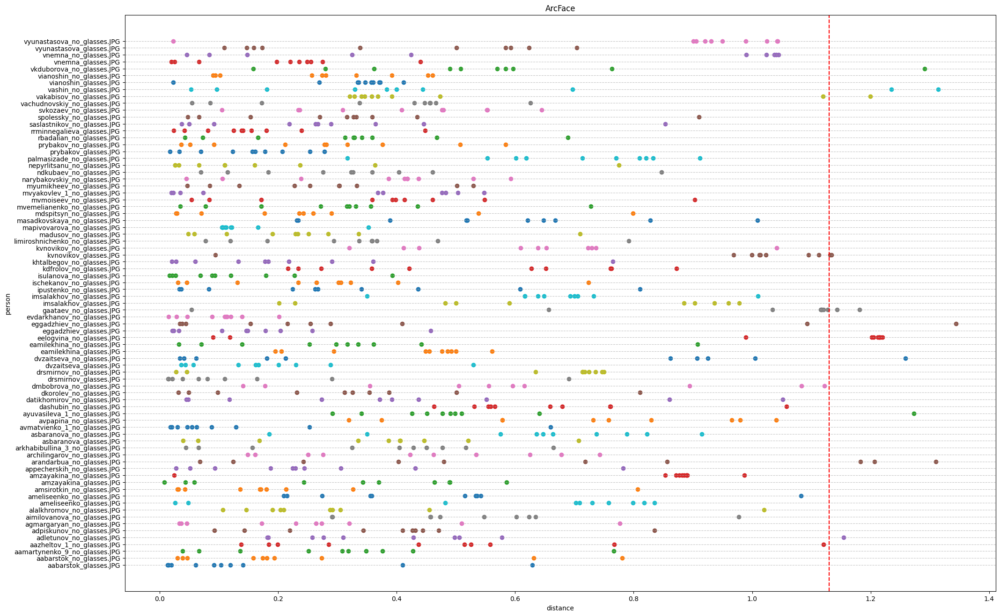

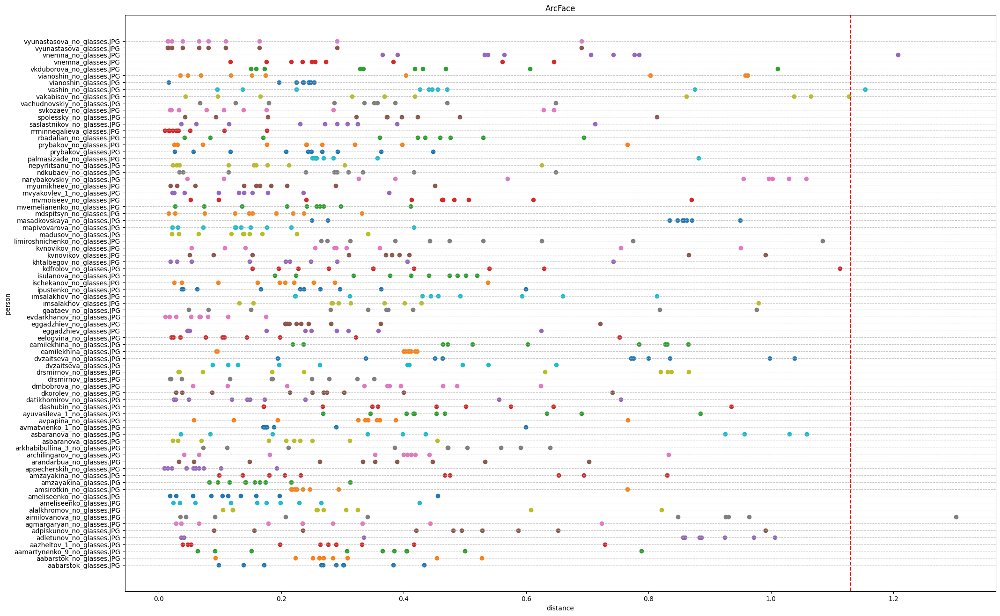

...

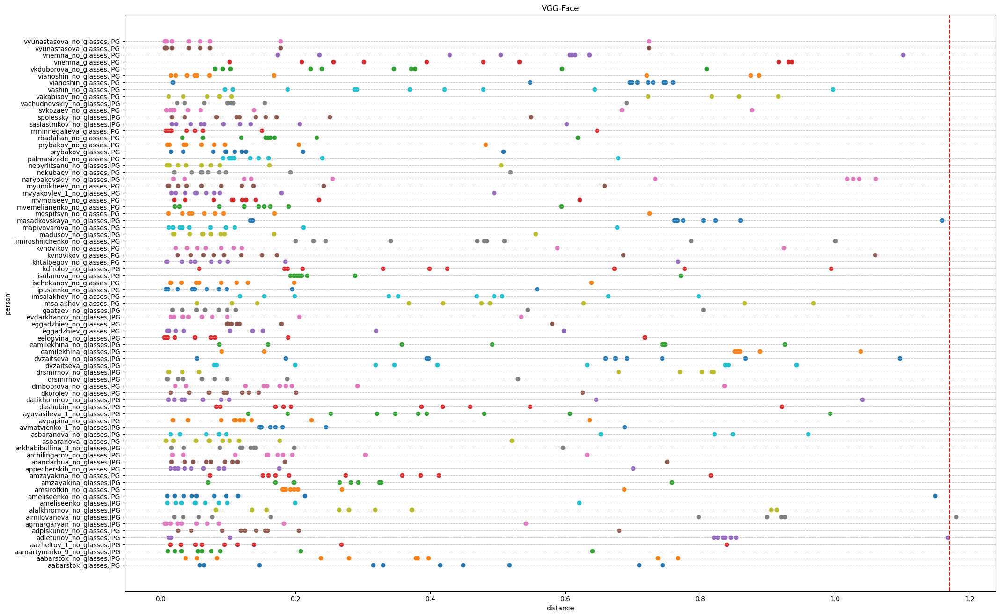

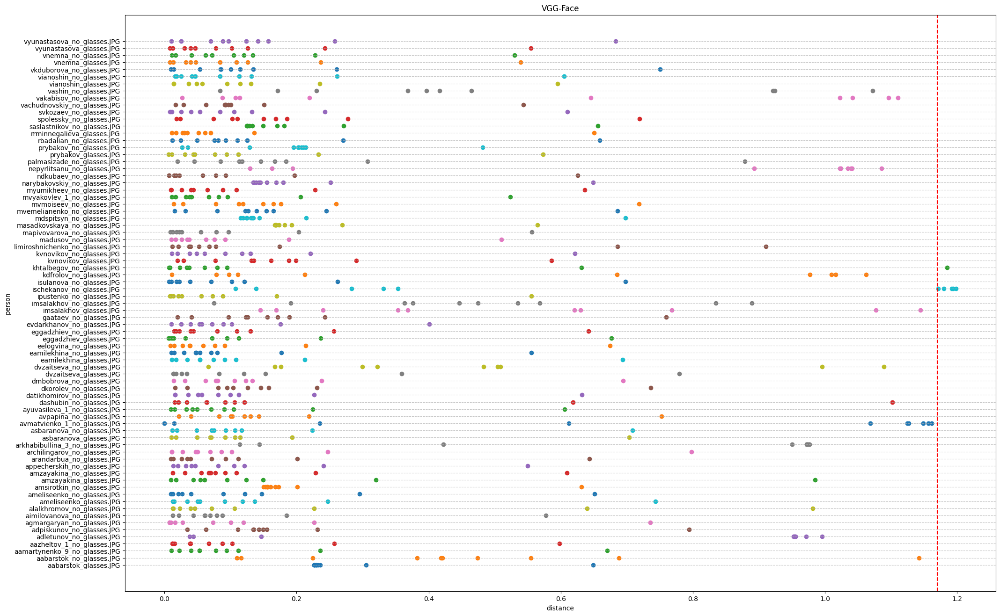

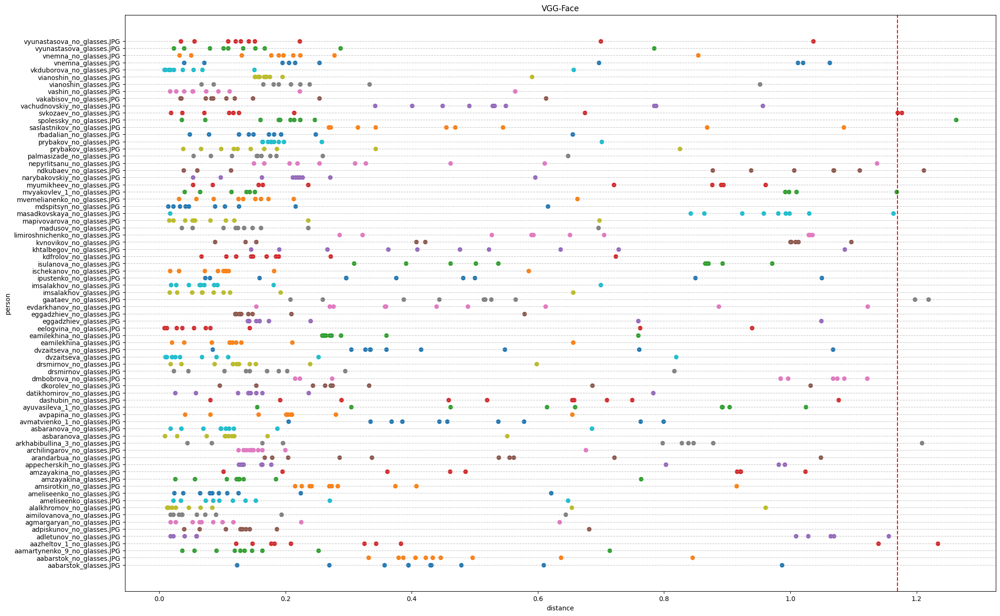

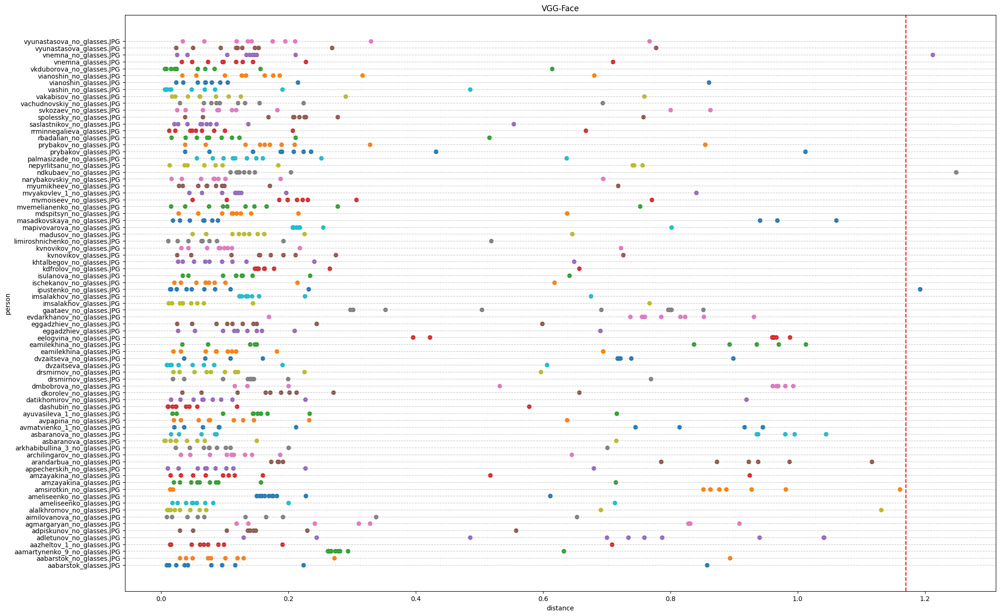

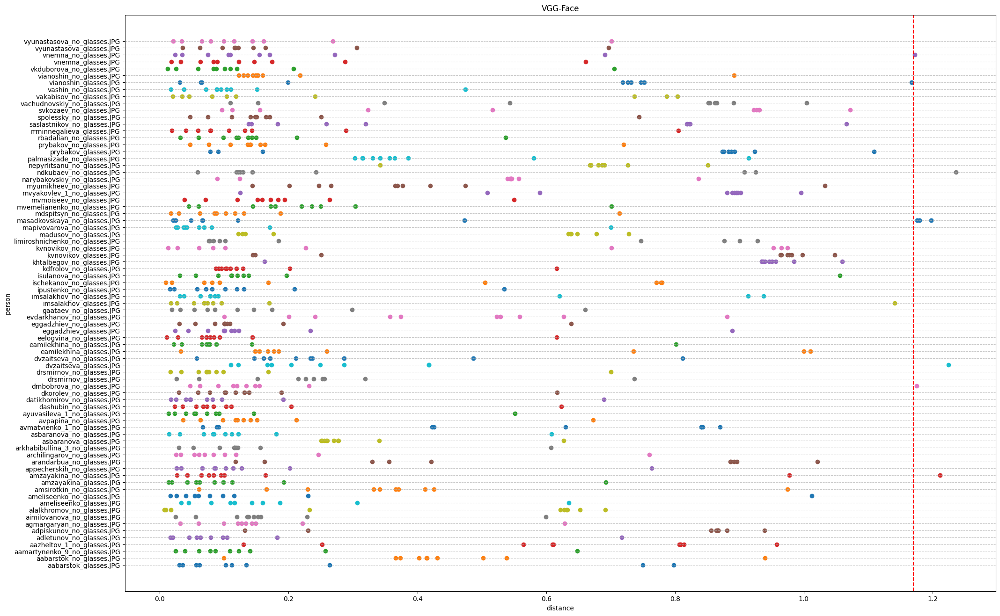

In [5]:
for file_name in os.listdir(input_folder):
  if file_name.endswith('.csv'):

    model_name = file_name.split('_')[0]
    df = pd.read_csv(os.path.join(input_folder, file_name))

    df_sorted = df.sort_values(by='name')

    distance_columns = [col for col in df_sorted.columns if '_distance' in col]
    plt.figure(figsize=(24, 16))

    for name, group in df_sorted.groupby('name'):
       distances = group[distance_columns].values.flatten()
       plt.scatter(distances, [name] * len(distances), marker='o')

    plt.title(f'{model_name}')
    plt.xlabel('distance')
    plt.ylabel('person')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.axvline(x=thresholds.get(model_name, 0), color='red', linestyle='--')
    plt.show()